┌ Info: Saved animation to /Users/shimizudan/Documents/Teaching_materials/2024/20241106mars/mars_epicycle_long_animation.gif
└ @ Plots /Users/shimizudan/.julia/packages/Plots/kLeqV/src/animation.jl:156


Plots.AnimatedGif("/Users/shimizudan/Documents/Teaching_materials/2024/20241106mars/mars_epicycle_long_animation.gif")
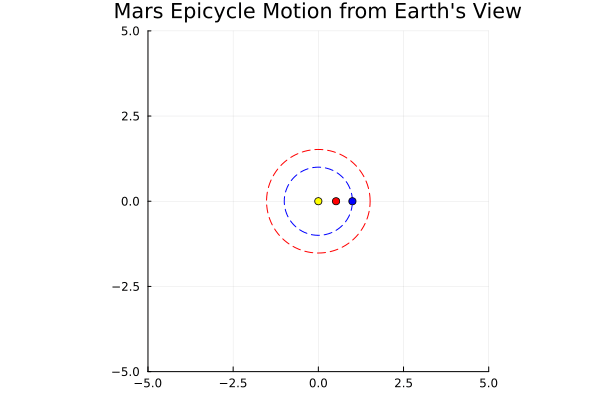

In [6]:
using Plots
using LinearAlgebra

# 軌道の周期と半径（相対的な値）
earth_period = 365.25       # 地球の周期（日）
mars_period = 687.0         # 火星の周期（日）
earth_orbit_radius = 1.0    # 地球の軌道半径
mars_orbit_radius = 1.52    # 火星の軌道半径

# 時間ステップと期間の設定
t_max = 365.25 * 10          # 10年間のスパン
dt = 5.0                    # 5日ごとのステップ
times = 0:dt:t_max

# 地球と火星の位置計算
earth_positions = [earth_orbit_radius * [cos(2π * t / earth_period), sin(2π * t / earth_period)] for t in times]
mars_positions = [mars_orbit_radius * [cos(2π * t / mars_period), sin(2π * t / mars_period)] for t in times]

# 地球から見た火星の位置
mars_relative_positions = [mars_positions[i] - earth_positions[i] for i in 1:length(times)]

# 軌道の円を生成
theta = range(0, 2π, length=100)
earth_orbit_circle = [(earth_orbit_radius * cos(θ), earth_orbit_radius * sin(θ)) for θ in theta]
mars_orbit_circle = [(mars_orbit_radius * cos(θ), mars_orbit_radius * sin(θ)) for θ in theta]

# アニメーション
animation = @animate for i in 1:length(times)
    plot(xlims=(-5, 5), ylims=(-5, 5), aspect_ratio=1, legend=false, title="Mars Epicycle Motion from Earth's View")
    
    # 軌道の円（地球と火星）
    plot!([p[1] for p in earth_orbit_circle], [p[2] for p in earth_orbit_circle], color=:blue, linestyle=:dash, label="Earth Orbit")
    plot!([p[1] for p in mars_orbit_circle], [p[2] for p in mars_orbit_circle], color=:red, linestyle=:dash, label="Mars Orbit")

    # 火星の軌跡（過去の軌跡を描く）
    plot!([p[1] for p in mars_relative_positions[1:i]], [p[2] for p in mars_relative_positions[1:i]], color=:red, label="Mars Path")
    
    # 現在の地球と火星の位置
    scatter!([0], [0], label="Sun", color=:yellow)  # 太陽は原点
    scatter!([earth_positions[i][1]], [earth_positions[i][2]], label="Earth", color=:blue)
    scatter!([mars_relative_positions[i][1]], [mars_relative_positions[i][2]], label="Mars", color=:red)
end

# GIFで保存または表示
gif(animation, "mars_epicycle_long_animation.gif", fps=20)

┌ Info: Saved animation to /Users/shimizudan/Documents/Teaching_materials/2024/20241106mars/earth_centered_sun_mars_orbits.gif
└ @ Plots /Users/shimizudan/.julia/packages/Plots/kLeqV/src/animation.jl:156


Plots.AnimatedGif("/Users/shimizudan/Documents/Teaching_materials/2024/20241106mars/earth_centered_sun_mars_orbits.gif")
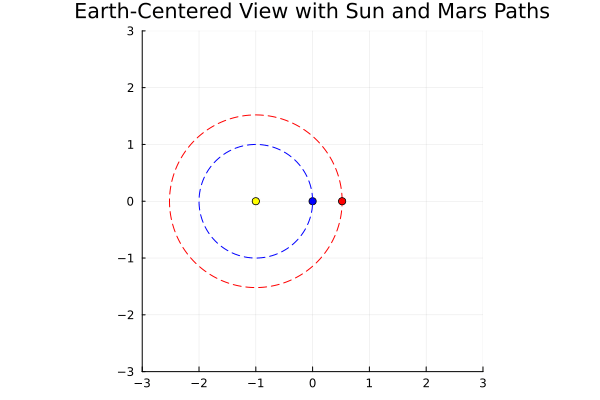

In [12]:
using Plots
using LinearAlgebra

# 軌道の周期と半径（相対的な値）
earth_period = 365.25       # 地球の周期（日）
mars_period = 687.0         # 火星の周期（日）
earth_orbit_radius = 1.0    # 地球の軌道半径
mars_orbit_radius = 1.52    # 火星の軌道半径

# 時間ステップと期間の設定
t_max = 365.25 * 2          # 50年間のスパン
dt = 5.0                    # 5日ごとのステップ
times = 0:dt:t_max

# 地球と火星の位置計算
earth_positions = [earth_orbit_radius * [cos(2π * t / earth_period), sin(2π * t / earth_period)] for t in times]
mars_positions = [mars_orbit_radius * [cos(2π * t / mars_period), sin(2π * t / mars_period)] for t in times]

# 地球から見た相対位置（太陽と火星）
sun_relative_positions = [-earth_positions[i] for i in 1:length(times)]
mars_relative_positions = [mars_positions[i] - earth_positions[i] for i in 1:length(times)]

# アニメーション
animation = @animate for i in 1:length(times)
    plot(xlims=(-3, 3), ylims=(-3, 3), aspect_ratio=1, legend=false, title="Earth-Centered View with Sun and Mars Paths",fillcolor = :black)
    
    # 現在の地球の位置（固定）
    scatter!([0], [0], label="Earth (Fixed)", color=:blue)  # 地球は原点に固定
    
    # 太陽の動き
    scatter!([sun_relative_positions[i][1]], [sun_relative_positions[i][2]], label="Sun", color=:yellow)
    
    # 太陽中心の円軌道（地球と火星を通る円）
    plot!([sun_relative_positions[i][1] + earth_orbit_radius * cos(θ) for θ in 0:0.01:2π],
          [sun_relative_positions[i][2] + earth_orbit_radius * sin(θ) for θ in 0:0.01:2π], 
          color=:blue, linestyle=:dash, label="Earth's Orbit around Sun")
    plot!([sun_relative_positions[i][1] + mars_orbit_radius * cos(θ) for θ in 0:0.01:2π],
          [sun_relative_positions[i][2] + mars_orbit_radius * sin(θ) for θ in 0:0.01:2π], 
          color=:red, linestyle=:dash, label="Mars' Orbit around Sun")

    # 火星の軌跡（地球から見た相対軌跡）
    plot!([p[1] for p in mars_relative_positions[1:i]], [p[2] for p in mars_relative_positions[1:i]], color=:red, label="Mars Path")
    scatter!([mars_relative_positions[i][1]], [mars_relative_positions[i][2]], label="Mars", color=:red)
end

# GIFで保存または表示
gif(animation, "earth_centered_sun_mars_orbits.gif", fps=20)

┌ Info: Saved animation to /Users/shimizudan/Documents/Teaching_materials/2024/20241106mars/earth_centered_sun_mars_orbits_black_bg.gif
└ @ Plots /Users/shimizudan/.julia/packages/Plots/kLeqV/src/animation.jl:156


Plots.AnimatedGif("/Users/shimizudan/Documents/Teaching_materials/2024/20241106mars/earth_centered_sun_mars_orbits_black_bg.gif")
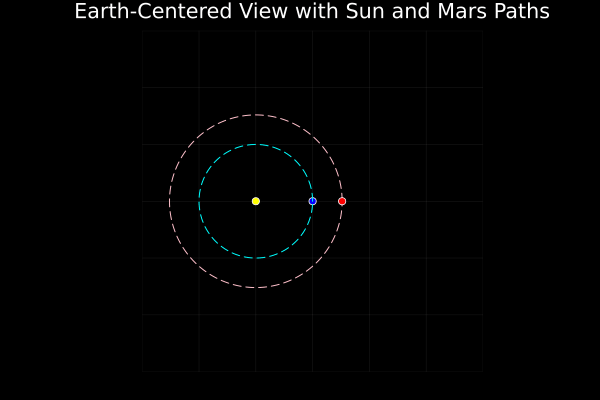

In [21]:
using Plots
using LinearAlgebra

# 軌道の周期と半径（相対的な値）
earth_period = 365.25       # 地球の周期（日）
mars_period = 687.0         # 火星の周期（日）
earth_orbit_radius = 1.0    # 地球の軌道半径
mars_orbit_radius = 1.52    # 火星の軌道半径

# 時間ステップと期間の設定
t_max = 365.25 * 30          # 50年間のスパン
dt = 5.0                    # 5日ごとのステップ
times = 0:dt:t_max

# 地球と火星の位置計算
earth_positions = [earth_orbit_radius * [cos(2π * t / earth_period), sin(2π * t / earth_period)] for t in times]
mars_positions = [mars_orbit_radius * [cos(2π * t / mars_period), sin(2π * t / mars_period)] for t in times]

# 地球から見た相対位置（太陽と火星）
sun_relative_positions = [-earth_positions[i] for i in 1:length(times)]
mars_relative_positions = [mars_positions[i] - earth_positions[i] for i in 1:length(times)]

# アニメーション
animation = @animate for i in 1:length(times)
    plot(xlims=(-3, 3), ylims=(-3, 3), aspect_ratio=1, legend=false, title="Earth-Centered View with Sun and Mars Paths", background_color=:black,axis=false)
    
    # 現在の地球の位置（固定）
    scatter!([0], [0], label="Earth (Fixed)", color=:blue)  # 地球は原点に固定
    
    # 太陽の動き
    scatter!([sun_relative_positions[i][1]], [sun_relative_positions[i][2]], label="Sun", color=:yellow)
    
    # 太陽中心の円軌道（地球と火星を通る円）
    plot!([sun_relative_positions[i][1] + earth_orbit_radius * cos(θ) for θ in 0:0.01:2π],
          [sun_relative_positions[i][2] + earth_orbit_radius * sin(θ) for θ in 0:0.01:2π], 
          color=:aqua, linestyle=:dash, label="Earth's Orbit around Sun")
    plot!([sun_relative_positions[i][1] + mars_orbit_radius * cos(θ) for θ in 0:0.01:2π],
          [sun_relative_positions[i][2] + mars_orbit_radius * sin(θ) for θ in 0:0.01:2π], 
          color=:pink, linestyle=:dash, label="Mars' Orbit around Sun")

    # 火星の軌跡（地球から見た相対軌跡）
    plot!([p[1] for p in mars_relative_positions[1:i]], [p[2] for p in mars_relative_positions[1:i]], color=:red, label="Mars Path")
    scatter!([mars_relative_positions[i][1]], [mars_relative_positions[i][2]], label="Mars", color=:red)
end

# GIFで保存または表示
gif(animation, "earth_centered_sun_mars_orbits_black_bg.gif", fps=20)

┌ Info: Saved animation to /Users/shimizudan/Documents/Teaching_materials/2024/20241106mars/earth_centered_orbits.gif
└ @ Plots /Users/shimizudan/.julia/packages/Plots/kLeqV/src/animation.jl:156


Plots.AnimatedGif("/Users/shimizudan/Documents/Teaching_materials/2024/20241106mars/earth_centered_orbits.gif")
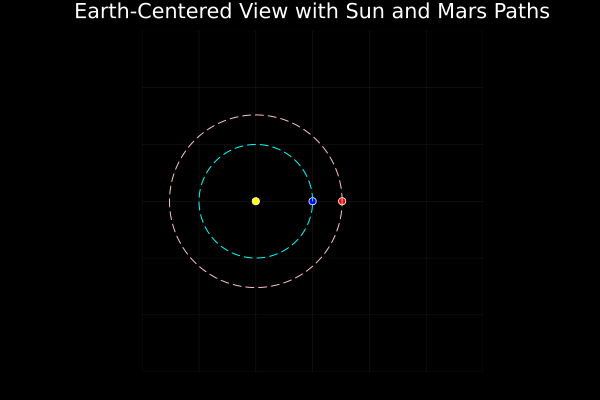

In [24]:
using Plots, LinearAlgebra

# パラメータ
ep, mp = 365.25, 687.0
er, mr = 1.0, 1.52
t_max, dt = 365.25 * 2, 5.0
times = 0:dt:t_max

# 地球と火星の位置
e_pos = [er * [cos(2π * t / ep), sin(2π * t / ep)] for t in times]
m_pos = [mr * [cos(2π * t / mp), sin(2π * t / mp)] for t in times]
sun_rel = [-e for e in e_pos]
mars_rel = [m_pos[i] - e_pos[i] for i in 1:length(times)]

# アニメーション
anim = @animate for i in 1:length(times)
    plot(xlims=(-3, 3), ylims=(-3, 3), aspect_ratio=1, title="Earth-Centered View with Sun and Mars Paths",legend=false, background_color=:black,axis=false)

    # 太陽・地球・火星
    scatter!([0], [0], color=:blue)  
    scatter!([sun_rel[i][1]], [sun_rel[i][2]], color=:yellow)
    scatter!([mars_rel[i][1]], [mars_rel[i][2]], color=:red)
    
    # 太陽中心の円軌道
    plot!([sun_rel[i][1] + er * cos(θ) for θ in 0:0.01:2π],
          [sun_rel[i][2] + er * sin(θ) for θ in 0:0.01:2π], color=:aqua, linestyle=:dash)
    plot!([sun_rel[i][1] + mr * cos(θ) for θ in 0:0.01:2π],
          [sun_rel[i][2] + mr * sin(θ) for θ in 0:0.01:2π], color=:pink, linestyle=:dash)

    # 火星の軌跡
    plot!([p[1] for p in mars_rel[1:i]], [p[2] for p in mars_rel[1:i]], color=:red)
end

gif(anim, "earth_centered_orbits.gif", fps=20)

┌ Info: Saved animation to /Users/shimizudan/Documents/Teaching_materials/2024/20241106mars/earth_centered_orbits.gif
└ @ Plots /Users/shimizudan/.julia/packages/Plots/kLeqV/src/animation.jl:156


Plots.AnimatedGif("/Users/shimizudan/Documents/Teaching_materials/2024/20241106mars/earth_centered_orbits.gif")
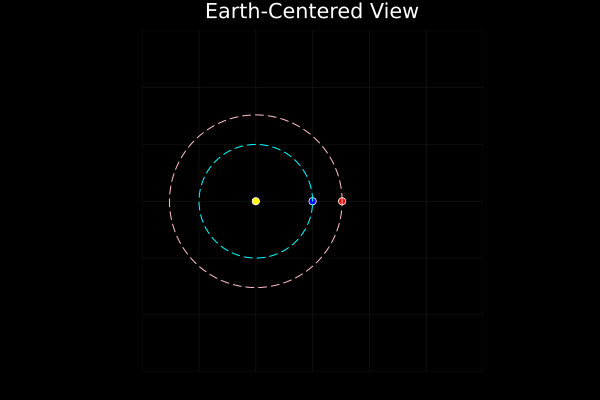

In [25]:
using Plots, LinearAlgebra

ep, mp, er, mr = 365.25, 687.0, 1.0, 1.52
t_max, dt = 365.25 * 2, 5.0
times = 0:dt:t_max

e_pos = [er * [cos(2π * t / ep), sin(2π * t / ep)] for t in times]
m_pos = [mr * [cos(2π * t / mp), sin(2π * t / mp)] for t in times]
sun_rel = [-e for e in e_pos]
mars_rel = [m_pos[i] - e_pos[i] for i in 1:length(times)]

anim = @animate for i in 1:length(times)
    plot(xlims=(-3, 3), ylims=(-3, 3), aspect_ratio=1, title="Earth-Centered View", legend=false, background_color=:black, axis=false)

    scatter!([0], [0], color=:blue)
    scatter!([sun_rel[i][1]], [sun_rel[i][2]], color=:yellow)
    scatter!([mars_rel[i][1]], [mars_rel[i][2]], color=:red)
    
    plot!([sun_rel[i][1] + er * cos(θ) for θ in 0:0.01:2π],
          [sun_rel[i][2] + er * sin(θ) for θ in 0:0.01:2π], color=:aqua, linestyle=:dash)
    plot!([sun_rel[i][1] + mr * cos(θ) for θ in 0:0.01:2π],
          [sun_rel[i][2] + mr * sin(θ) for θ in 0:0.01:2π], color=:pink, linestyle=:dash)

    plot!([p[1] for p in mars_rel[1:i]], [p[2] for p in mars_rel[1:i]], color=:red)
end

gif(anim, "earth_centered_orbits.gif", fps=20)

┌ Info: Saved animation to /Users/shimizudan/Documents/Teaching_materials/2024/20241106mars/earth_centered_sun_venus_orbits_black_bg_bold.gif
└ @ Plots /Users/shimizudan/.julia/packages/Plots/kLeqV/src/animation.jl:156


Plots.AnimatedGif("/Users/shimizudan/Documents/Teaching_materials/2024/20241106mars/earth_centered_sun_venus_orbits_black_bg_bold.gif")
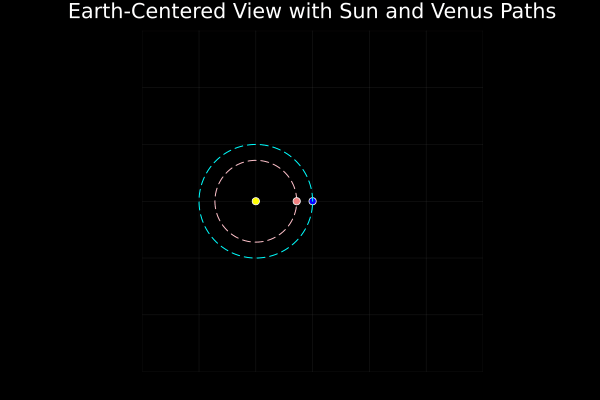

In [3]:
using Plots
using LinearAlgebra

# 軌道の周期と半径（相対的な値）
earth_period = 365.25        # 地球の周期（日）
venus_period = 224.7         # 金星の周期（日）
earth_orbit_radius = 1.0     # 地球の軌道半径
venus_orbit_radius = 0.72    # 金星の軌道半径

# 時間ステップと期間の設定
t_max = 365.25 * 30          # 30年間のスパン
dt = 5.0                     # 5日ごとのステップ
times = 0:dt:t_max

# 地球と金星の位置計算
earth_positions = [earth_orbit_radius * [cos(2π * t / earth_period), sin(2π * t / earth_period)] for t in times]
venus_positions = [venus_orbit_radius * [cos(2π * t / venus_period), sin(2π * t / venus_period)] for t in times]

# 地球から見た相対位置（太陽と金星）
sun_relative_positions = [-earth_positions[i] for i in 1:length(times)]
venus_relative_positions = [venus_positions[i] - earth_positions[i] for i in 1:length(times)]

# アニメーション
animation = @animate for i in 1:length(times)
    plot(xlims=(-3, 3), ylims=(-3, 3), aspect_ratio=1, legend=false, title="Earth-Centered View with Sun and Venus Paths", background_color=:black, axis=false)
    
    # 現在の地球の位置（固定）
    scatter!([0], [0], label="Earth (Fixed)", color=:blue)  # 地球は原点に固定
    
    # 太陽の動き
    scatter!([sun_relative_positions[i][1]], [sun_relative_positions[i][2]], label="Sun", color=:yellow)
    
    # 太陽中心の円軌道（地球と金星を通る円）
    plot!([sun_relative_positions[i][1] + earth_orbit_radius * cos(θ) for θ in 0:0.01:2π],
          [sun_relative_positions[i][2] + earth_orbit_radius * sin(θ) for θ in 0:0.01:2π], 
          color=:aqua, linestyle=:dash, label="Earth's Orbit around Sun")
    plot!([sun_relative_positions[i][1] + venus_orbit_radius * cos(θ) for θ in 0:0.01:2π],
          [sun_relative_positions[i][2] + venus_orbit_radius * sin(θ) for θ in 0:0.01:2π], 
          color=:pink, linestyle=:dash, label="Venus' Orbit around Sun")

    # 金星の軌跡（地球から見た相対軌跡） - 太さと色の調整
    plot!([p[1] for p in venus_relative_positions[1:i]], 
          [p[2] for p in venus_relative_positions[1:i]], 
          color=:lightcoral, linewidth=3, label="Venus Path")
    scatter!([venus_relative_positions[i][1]], [venus_relative_positions[i][2]], label="Venus", color=:lightcoral)
end

# GIFで保存または表示
gif(animation, "earth_centered_sun_venus_orbits_black_bg_bold.gif", fps=20)